In [3]:
import os
import pandas as pd
import re
import tensorflow as tf
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colors
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.activations import linear, relu, sigmoid, softmax
from tensorflow.keras.optimizers import*
from sklearn.metrics import accuracy_score, recall_score, confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import f1_score
from sklearn.model_selection import train_test_split
import matplotlib.pyplot as plt
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.regularizers import l1, l2
from tensorflow.keras.layers import Dense, BatchNormalization
from collections import Counter


In [4]:
df = pd.read_csv(r"/users/eleves-a/2022/mariem.ould-ismail/PSC/modele merimam/dataset_river_final.csv", header = 0)
df

,game_id,stack,river_position,nb_players_start,cards,pot_size_before_decision,nb_unfolded_players,money_to_add_to_call,hand_strength,hand_pos_potential,hand_neg_potential,last_raise__turn_player,last_raise_riverplayer,flop,turn,river,mise en cas de raise/bet,decision
0,808938724,15.70,0,4,Th Kh,10.90,2,0.00,0.410101,0,0,-1,-1,6d Ad 5d,7c,5h,0.0,checks
1,808938165,6.01,0,7,Ah Jh,6.25,2,2.42,0.626263,0,0,-1,1,8c Js Qd,9d,6s,0.0,folds
2,808936976,6.53,0,6,Jd 6c,3.17,2,1.23,0.616162,0,0,1,1,6s 8d 3c,Ks,2s,0.0,folds
3,808931232,23.57,1,6,Ah 3c,12.86,2,10.00,0.912626,0,0,1,-1,5c 2c 6h,4h,Jd,10.0,bets
4,808931130,4.70,0,3,9c As,1.94,3,0.00,0.336869,0,0,-1,-1,5s Qc 7d,Ts,Js,0.0,checks
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2159,788450478,10.22,0,4,9d 9s,9.81,2,0.00,0.724747,0,0,0,-1,3s 6c 4d,Qh,6s,0.0,checks
2160,788428425,50.30,0,9,Qh Qs,118.32,3,58.14,0.594444,0,0,-1,1,Kh 9s 8h,7c,Jh,0.0,folds
2161,788424042,50.73,1,8,6h Th,18.54,2,0.00,0.804040,0,0,1,-1,2c 4h Tc,3h,8s,0.0,checks
2162,788424042,50.73,1,8,6h Th,34.17,2,15.63,0.804040,0,0,1,0,2c 4h Tc,3h,8s,0.0,calls


In [5]:
df["card_1_player"]=0 
df["card_2_player"]=0
df["color_1_player"]=0
df["color_2_player"] =0
df["card_1_board"]= 0
df["card_2_board"] = 0
df["card_3_board"]= 0
df["card_4_board"]= 0
df["card_5_board"]= 0
df["color_5_board"] =0
df["color_4_board"]=0
df["color_3_board"]=0
df["color_2_board"] = 0
df["color_1_board"] =0
df['decision'] = df['decision'].replace({'checks': 'calls', 'bets': 'raises'})
df

,game_id,stack,river_position,nb_players_start,cards,pot_size_before_decision,nb_unfolded_players,money_to_add_to_call,hand_strength,hand_pos_potential,...,card_1_board,card_2_board,card_3_board,card_4_board,card_5_board,color_5_board,color_4_board,color_3_board,color_2_board,color_1_board
0,808938724,15.70,0,4,Th Kh,10.90,2,0.00,0.410101,0,...,0,0,0,0,0,0,0,0,0,0
1,808938165,6.01,0,7,Ah Jh,6.25,2,2.42,0.626263,0,...,0,0,0,0,0,0,0,0,0,0
2,808936976,6.53,0,6,Jd 6c,3.17,2,1.23,0.616162,0,...,0,0,0,0,0,0,0,0,0,0
3,808931232,23.57,1,6,Ah 3c,12.86,2,10.00,0.912626,0,...,0,0,0,0,0,0,0,0,0,0
4,808931130,4.70,0,3,9c As,1.94,3,0.00,0.336869,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2159,788450478,10.22,0,4,9d 9s,9.81,2,0.00,0.724747,0,...,0,0,0,0,0,0,0,0,0,0
2160,788428425,50.30,0,9,Qh Qs,118.32,3,58.14,0.594444,0,...,0,0,0,0,0,0,0,0,0,0
2161,788424042,50.73,1,8,6h Th,18.54,2,0.00,0.804040,0,...,0,0,0,0,0,0,0,0,0,0
2162,788424042,50.73,1,8,6h Th,34.17,2,15.63,0.804040,0,...,0,0,0,0,0,0,0,0,0,0


In [6]:
def quantifier_correspondances_couleur(A, B, C):
    # Combiner les tableaux A, B et C pour obtenir toutes les couleurs
    toutes_couleurs = A + B + C

    # Compter les occurrences de chaque couleur
    comptage_couleurs = Counter(toutes_couleurs)

    # Obtenir le nombre maximum d'occurrences d'une même couleur
    max_occurrences = max(comptage_couleurs.values())
    occurrences = list(comptage_couleurs.values())

    # Appliquer la règle de conversion
    if max_occurrences == 5:
        return 5
    elif max_occurrences == 4:
        return 4
    elif max_occurrences == 3:
        if occurrences.count(3) == 1 and occurrences.count(2) == 1:
            return 3
        else:
            return 2
    elif max_occurrences == 2:
        if occurrences.count(2) == 2:
            return 1
        else:
            return 0

# Exemple d'utilisation
A = ['rouge', 'jaune', 'bleu']  # Couleurs des cartes du flop
B = ['rouge']                 # Couleur de la carte du turn
C = ['vert']                  # Couleur de la carte du river

resultat = quantifier_correspondances_couleur(A, B, C)
print("Score :", resultat)

Score : 0


In [7]:
cards = df["cards"]
deck = df["flop"]
#cards

def get_value(s):
  if s == 'A':
    return 14
  if s=='K':
    return 13
  if s== 'Q':
    return 12
  if s== 'J':
    return 11
  if (s == '1') | (s == 'T'):
    return 10
  return int(s)

def get_color(s):
  if s=='s':
    return 0
  elif s =='h':
    return 1
  elif s=='d':
    return 2
  else :
    return 3

for i in range(df.shape[0]):
  index = 0
  j = 0
  k = 0
  l = 0
  values = []
  values_deck = []
  value_turn = []
  value_river = []
  c = df['cards'][i]
  d = df['flop'][i]
  t = df["turn"][i]
  r = df["river"][i]
  if c[0] == "1":
    values.append(10)
    index+=1
  else :
    values.append(get_value(c[0]))

  index += 1
  values.append(c[index])
  index+=2
  if c[index] == "1":
    values.append(10)
    index+=1
  else :
    values.append(get_value(c[index]))

  index += 1
  values.append(c[index])

  if t[0] == "1":
    value_turn.append(10)
    k+=1
  else :
    value_turn.append(get_value(t[0]))
  k+=1
  value_turn.append(t[k])

  if r[0] == "1":
    value_river.append(10)
    l+=1
  else :
    value_river.append(get_value(r[0]))
  l+=1
  value_river.append(r[l])

  if d[0] == "1":
    values_deck.append(10)
    j += 1
  else :
    values_deck.append(get_value(d[0]))

  j += 1
  values_deck.append(d[j])
  j +=2
  if d[j] == "1":
    values_deck.append(10)
    j += 1
  else :
    values_deck.append(get_value(d[j]))

  j += 1
  values_deck.append(d[j])

  j +=2
  if d[j] == "1":
    values_deck.append(10)
    j += 1
  else :
    values_deck.append(get_value(d[j]))

  j += 1
  values_deck.append(d[j])

  
  df["card_1_player"][i] = values[0] 
  df["card_2_player"][i] = values[2] 
  df["color_1_player"][i] = get_color(values[1])
  df["color_2_player"][i] = get_color(values[3])
  df["card_1_board"][i]= values_deck[0]
  df["card_2_board"][i] = values_deck[2]
  df["card_3_board"][i] = values_deck[4]
  df["card_4_board"][i]= value_turn[0]
  df["card_5_board"][i]= value_river[0]
  df["color_5_board"][i]= get_color(value_river[1])
  df["color_4_board"][i] = get_color(value_turn[1])
  df["color_3_board"][i] = get_color(values_deck[5])
  df["color_2_board"][i] = get_color(values_deck[3])
  df["color_1_board"][i] = get_color(values_deck[1])



  if df['decision'][i] == 'folds' :
    df['decision'][i] = 0
  elif df['decision'][i] == 'calls' :
    df['decision'][i] = 1
  elif df['decision'][i] == 'raises' :
    df['decision'][i] = 2
  if i == 0 :
    print(values_deck)


df


[6, 'd', 14, 'd', 5, 'd']


/tmp/ipykernel_2487476/3774094036.py:104: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  df["card_1_player"][i] = values[0]
/tmp/ipykernel_2487476/3774094036.py:104: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice fr

,game_id,stack,river_position,nb_players_start,cards,pot_size_before_decision,nb_unfolded_players,money_to_add_to_call,hand_strength,hand_pos_potential,...,card_1_board,card_2_board,card_3_board,card_4_board,card_5_board,color_5_board,color_4_board,color_3_board,color_2_board,color_1_board
0,808938724,15.70,0,4,Th Kh,10.90,2,0.00,0.410101,0,...,6,14,5,7,5,1,3,2,2,2
1,808938165,6.01,0,7,Ah Jh,6.25,2,2.42,0.626263,0,...,8,11,12,9,6,0,2,2,0,3
2,808936976,6.53,0,6,Jd 6c,3.17,2,1.23,0.616162,0,...,6,8,3,13,2,0,0,3,2,0
3,808931232,23.57,1,6,Ah 3c,12.86,2,10.00,0.912626,0,...,5,2,6,4,11,2,1,1,3,3
4,808931130,4.70,0,3,9c As,1.94,3,0.00,0.336869,0,...,5,12,7,10,11,0,0,2,3,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2159,788450478,10.22,0,4,9d 9s,9.81,2,0.00,0.724747,0,...,3,6,4,12,6,0,1,2,3,0
2160,788428425,50.30,0,9,Qh Qs,118.32,3,58.14,0.594444,0,...,13,9,8,7,11,1,3,1,0,1
2161,788424042,50.73,1,8,6h Th,18.54,2,0.00,0.804040,0,...,2,4,10,3,8,0,1,3,1,3
2162,788424042,50.73,1,8,6h Th,34.17,2,15.63,0.804040,0,...,2,4,10,3,8,0,1,3,1,3


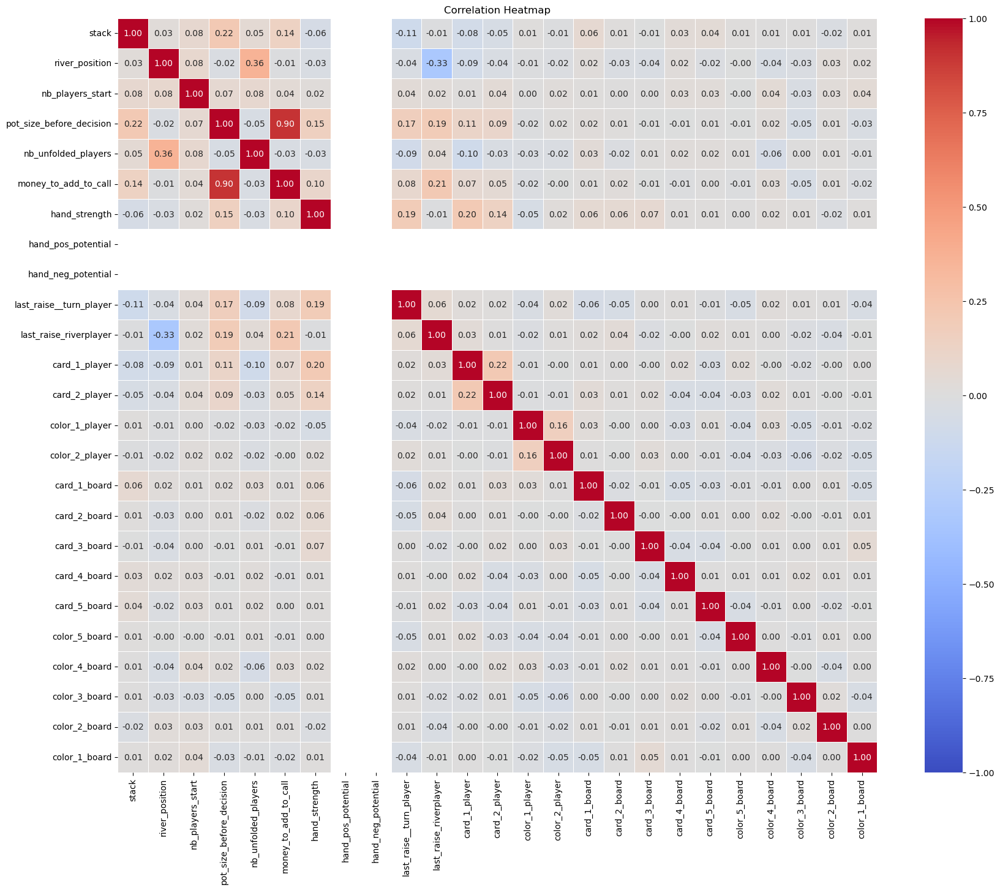

In [8]:
features = df.drop(columns=['game_id', 'decision', 'cards', 'flop', 'turn', 'river', 'mise en cas de raise/bet'])
M = features.corr()


plt.figure(figsize=(20, 16))
sns.heatmap(M, annot=True, cmap="coolwarm", linewidths=0.5, fmt=".2f", vmin=-1, vmax=1)
plt.title("Correlation Heatmap")
plt.show()

In [9]:
# Training
features = df.drop(columns=['game_id', 'decision', 'cards', 'flop', 'turn', 'river', 'mise en cas de raise/bet']).values.astype(np.float32)
labels = df['decision']
labels = labels.values.astype(np.float32)
X_train, X_test, Y_train, Y_test = train_test_split(features, labels, random_state = 42)

model = Sequential(
    [
      tf.keras.Input(shape=(X_train.shape[1],)),
      Dense(units=32,activation='relu',name='layer1'),
      Dropout(0.2),
      Dense(units=32,activation='relu',name='layer2'),
      Dropout(0.2),
      
      Dense(units=3,activation='softmax',name='layer3')

    ], name = "river_model1"
)

features = df.drop(columns=['game_id', 'decision', 'cards', 'flop', 'turn', 'river', 'mise en cas de raise/bet']).values.astype(np.float32)
labels = df['decision']
labels = labels.values.astype(np.float32)
X_train, X_test, Y_train, Y_test = train_test_split(features, labels, random_state = 42)

model.compile(
    loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=False),
    optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
    metrics = ['accuracy']
)

early_stopping = EarlyStopping(monitor='accuracy', patience=100, restore_best_weights=True)

history = model.fit(   X_train,Y_train,    epochs=1000, callbacks=[early_stopping], validation_data=(X_test, Y_test))

Epoch 1/1000


2024-04-26 09:19:09.015771: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:998] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-04-26 09:19:09.016083: W tensorflow/core/common_runtime/gpu/gpu_device.cc:2251] Cannot dlopen some GPU libraries. Please make sure the missing libraries mentioned above are installed properly if you would like to use GPU. Follow the guide at https://www.tensorflow.org/install/gpu for how to download and setup the required libraries for your platform.
Skipping registering GPU devices...


51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 2ms/step - accuracy: 0.4871 - loss: 3.1260 - val_accuracy: 0.4991 - val_loss: 1.1620
Epoch 2/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 629us/step - accuracy: 0.4815 - loss: 1.5736 - val_accuracy: 0.5268 - val_loss: 1.0211
Epoch 3/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 637us/step - accuracy: 0.5249 - loss: 1.2631 - val_accuracy: 0.5416 - val_loss: 0.9860
Epoch 4/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 827us/step - accuracy: 0.5358 - loss: 1.1154 - val_accuracy: 0.5360 - val_loss: 0.9822
Epoch 5/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 686us/step - accuracy: 0.5293 - loss: 1.0610 - val_accuracy: 0.5453 - val_loss: 0.9709
Epoch 6/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 860us/step - accuracy: 0.5523 - loss: 1.0254 - val_accuracy: 0.5545 - val_loss: 0.9508
Epoch 7/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 868us/step - accuracy: 0.5659 - loss: 1.0068 - val_accuracy: 0.5471 - val_loss: 0.9383
Epoch 8/1000
51/51 ━━━━━━━━━━━━━━━━━━━━ 0s 697us/step - accuracy: 0.5610 - loss: 0.9703 - val_accuracy: 0

In [10]:
a = max(history.history['accuracy'])
b = max(history.history['val_accuracy'])
print(a)
print(b)

0.9463955760002136
0.831792950630188


17/17 ━━━━━━━━━━━━━━━━━━━━ 0s 946us/step


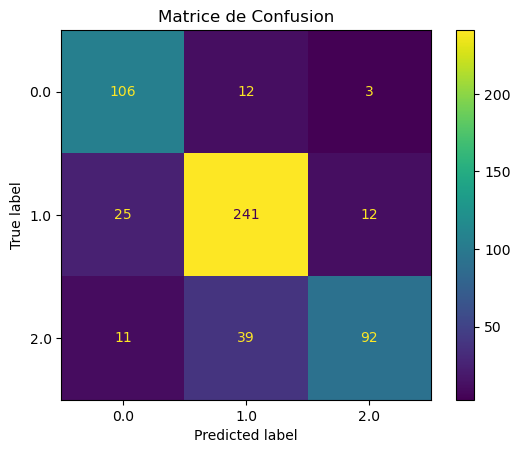

0.7968845028570021


In [11]:
y_true = Y_test
y_pred = model.predict(X_test)
y_pred = np.argmax(y_pred, axis=1)

ConfusionMatrixDisplay.from_predictions(y_true, y_pred)
plt.title('Matrice de Confusion')
plt.show()

f1 = f1_score(y_true, y_pred, average='macro')
print(f1)

In [12]:
model.save(r'C:\Users\ngoup\Downloads\modele_river.keras')


In [13]:
model.save(r'C:\Users\ngoup\Downloads\modele_river2')


ValueError: Invalid filepath extension for saving. Please add either a `.keras` extension for the native Keras format (recommended) or a `.h5` extension. Use `model.export(filepath)` if you want to export a SavedModel for use with TFLite/TFServing/etc. Received: filepath=C:\Users\ngoup\Downloads\modele_river2.

In [ ]:
from tensorflow.keras.models import load_model

model = load_model(r'C:\Users\ngoup\Downloads\modele_river.h5')

In [ ]:
model.weights

In [ ]:
model.save(r'/users/eleves-a/2022/mariem.ould-ismail/modele_river3.keras')